<a href="https://colab.research.google.com/github/santiagorg2401/tensorflow_course_exercises/blob/main/04_TransferLearning_03_ScalingUp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Transfer learning with TensorFlow, Part 3. Scaling Up.
In this notebook we're going to use all 101 classes on the Food101 dataset, hence scaling up.

## Solve importations.

In [14]:
import random
import numpy as np
import tensorflow as tf
import helper_functions as hf
import matplotlib.pyplot as plt

from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Check tensorflow version and get physical devices.
print(f"TensorFlow version: {tf.__version__}")
physical_devices = tf.config.list_physical_devices('GPU')
print(f"Physical GPUs: {physical_devices}")

TensorFlow version: 2.10.0
Physical GPUs: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Import and load the data.
Test set remain the same across all datasets.

### 101_food_classes_10_percent

There are 2 directories and 0 images in '101_food_classes_10_percent'.
There are 101 directories and 0 images in '101_food_classes_10_percent/train'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/poutine'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/prime_rib'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/ice_cream'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/clam_chowder'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/seaweed_salad'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/huevos_rancheros'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/ravioli'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/club_sandwich'.
There are 0 directories and 75 images in '101_food_classes_10_percent/train/grilled_cheese_sandwich'.
There are 0 directories and 75

2023-01-05 12:22:46.054327: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-05 12:22:46.054876: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-05 12:22:46.055094: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-01-05 12:22:46.055217: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zer

Found 25250 files belonging to 101 classes.
Class names: ['apple_pie', 'baby_back_ribs', 'baklava', 'beef_carpaccio', 'beef_tartare', 'beet_salad', 'beignets', 'bibimbap', 'bread_pudding', 'breakfast_burrito', 'bruschetta', 'caesar_salad', 'cannoli', 'caprese_salad', 'carrot_cake', 'ceviche', 'cheese_plate', 'cheesecake', 'chicken_curry', 'chicken_quesadilla', 'chicken_wings', 'chocolate_cake', 'chocolate_mousse', 'churros', 'clam_chowder', 'club_sandwich', 'crab_cakes', 'creme_brulee', 'croque_madame', 'cup_cakes', 'deviled_eggs', 'donuts', 'dumplings', 'edamame', 'eggs_benedict', 'escargots', 'falafel', 'filet_mignon', 'fish_and_chips', 'foie_gras', 'french_fries', 'french_onion_soup', 'french_toast', 'fried_calamari', 'fried_rice', 'frozen_yogurt', 'garlic_bread', 'gnocchi', 'greek_salad', 'grilled_cheese_sandwich', 'grilled_salmon', 'guacamole', 'gyoza', 'hamburger', 'hot_and_sour_soup', 'hot_dog', 'huevos_rancheros', 'hummus', 'ice_cream', 'lasagna', 'lobster_bisque', 'lobster_rol

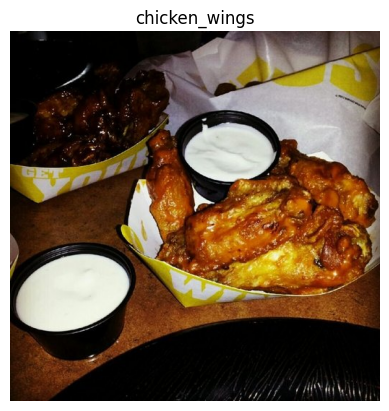

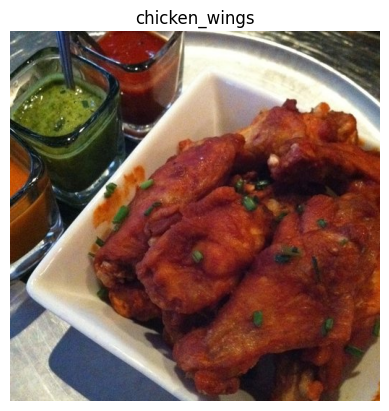

['2813842.jpg']
Image shape: (512, 512, 3)
['612548.jpg']
Image shape: (512, 512, 3)


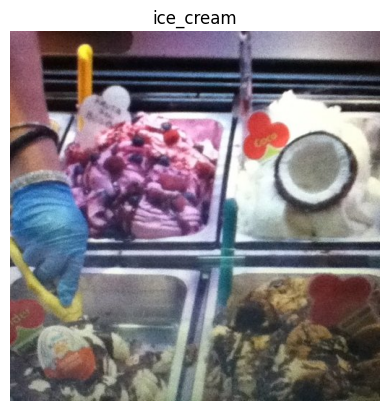

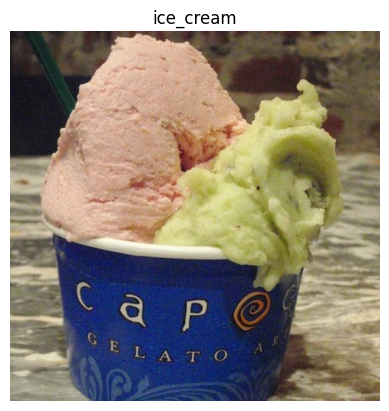

In [2]:
# Get data and walk through its directory.
try:
  hf.unzip_data("101_food_classes_10_percent.zip")
except:
  !wget https://storage.googleapis.com/ztm_tf_course/food_vision/101_food_classes_10_percent.zip
  hf.unzip_data("101_food_classes_10_percent.zip")

hf.walk_through_dir("101_food_classes_10_percent")

# Set up paths.
train_dir_10_percent = "101_food_classes_10_percent/train/"
test_dir = "101_food_classes_10_percent/test/"

# Set up parameters.
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
TFBOARD_DIR = "tensorboard_logs/04-TransferLearning-03-ScalingUp"
CHECKPOINT_DIR = "checkpoints/04-TransferLearning-03-ScalingUp"
MODEL_DIR = "models/04-TransferLearning-03-ScalingUp"

# Import datasets.
train_data_10_percent = image_dataset_from_directory(directory=train_dir_10_percent,
                                                     image_size=IMG_SIZE,
                                                     batch_size=BATCH_SIZE,
                                                     label_mode="categorical")

test_data = image_dataset_from_directory(directory=test_dir,
                                         image_size=IMG_SIZE,
                                         batch_size=BATCH_SIZE,
                                         label_mode="categorical",
                                         shuffle=False)

# Check class names.
class_names = test_data.class_names
print(f"Class names: {class_names}")

# Visualize.
img = hf.view_random_image(target_dir=train_dir_10_percent,
                        target_class='chicken_wings',
                        i=2)

img = hf.view_random_image(target_dir=train_dir_10_percent,
                        target_class='ice_cream',
                        i=2)

## `model_0` EfficientNetB0 baseline with feature extraction on 10% of training data with data augmentation.

### Data augmentation.

Non-augmented image.
['1367538.jpg']
Image shape: (512, 512, 3)


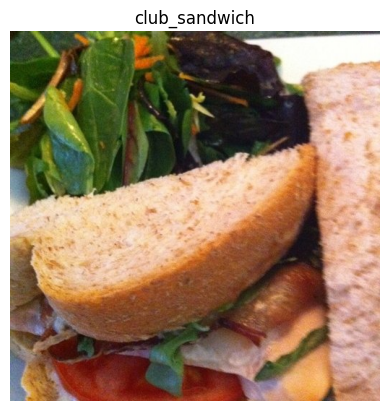

Augmented image.


(-0.5, 488.5, 520.5, -0.5)

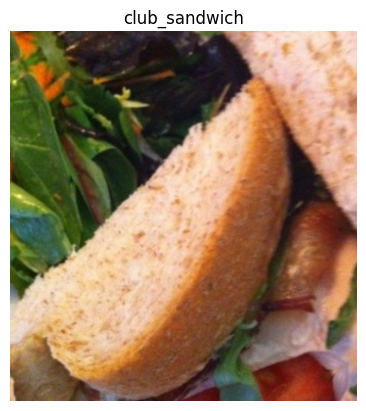

In [ ]:
data_augmentation_layer = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.2),
    layers.RandomHeight(0.2),
    layers.RandomWidth(0.2),
    layers.RandomZoom(0.2)
], name="data_augmentation_layer")

# Visualize.
print("Non-augmented image.")
target_class = random.choice(train_data_10_percent.class_names)
img = hf.view_random_image(train_dir_10_percent, target_class, i=1)

print("Augmented image.")
augmented_img = data_augmentation_layer(img, training=True)
plt.imshow(augmented_img/255.)
plt.title(target_class)
plt.axis(False)

### Create the model.

In [ ]:
# Setup input shape and base model.
input_shape = IMG_SIZE + (3,)
base_model = tf.keras.applications.EfficientNetB0(include_top=False)
base_model.trainable = False

# Create layers.
inputs = layers.Input(shape=input_shape, name="input_layer")
x = data_augmentation_layer(inputs)
x = base_model(x, training = False)
x = layers.GlobalAveragePooling2D(name="global_avg_pool_layer")(x)
outputs = layers.Dense(len(train_data_10_percent.class_names), activation="softmax", name="output_layer")(x)

# Create model.
model_0 = tf.keras.Model(inputs, outputs)

# Compile model.
model_0.compile(loss="categorical_crossentropy",
                optimizer=tf.keras.optimizers.Adam(),
                metrics=["accuracy"])

# Fit model.
history_0 = model_0.fit(train_data_10_percent,
                        epochs=5,
                        steps_per_epoch=len(train_data_10_percent),
                        validation_data=test_data,
                        validation_steps=len(test_data),
                        callbacks=[hf.create_tensorboard_callback(dir_name=TFBOARD_DIR,
                                                                  experiment_name="model_0"),
                                   hf.create_checkpoint_callback(dir_name=CHECKPOINT_DIR,
                                                                 experiment_name="model_0")])

# Get summary.
model_0.summary()

Saving TensorBoard log files to: tensorboard_logs/04-TransferLearning-03-ScalingUp/model_0/20230104-193507
Saving checkpoint to: checkpoints/04-TransferLearning-03-ScalingUp/model_0/checkpoint.ckpt
Epoch 1/5
237/237 [==============================] - ETA: 0s - loss: 3.3849 - accuracy: 0.2669WARNING:tensorflow:Model was constructed with shape (512, 512, 3) for input KerasTensor(type_spec=TensorSpec(shape=(512, 512, 3), dtype=tf.uint8, name='random_flip_5_input'), name='random_flip_5_input', description="created by layer 'random_flip_5_input'"), but it was called on an input with incompatible shape (None, 224, 224, 3).

Epoch 1: val_loss improved from inf to 2.31885, saving model to checkpoints/04-TransferLearning-03-ScalingUp/model_0/checkpoint.ckpt
237/237 [==============================] - 70s 278ms/step - loss: 3.3849 - accuracy: 0.2669 - val_loss: 2.3189 - val_accuracy: 0.4774
Epoch 2/5
237/237 [==============================] - ETA: 0s - loss: 2.2074 - accuracy: 0.4980
Epoch 2: val

### Evaluate the model.

In [ ]:
eval_0 = model_0.evaluate(test_data)

790/790 [==============================] - 44s 56ms/step - loss: 1.5823 - accuracy: 0.5830


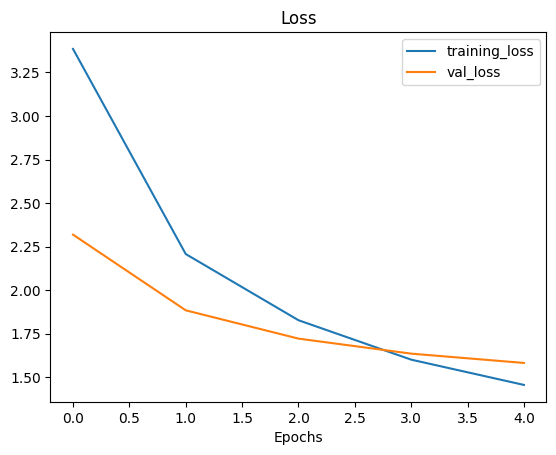

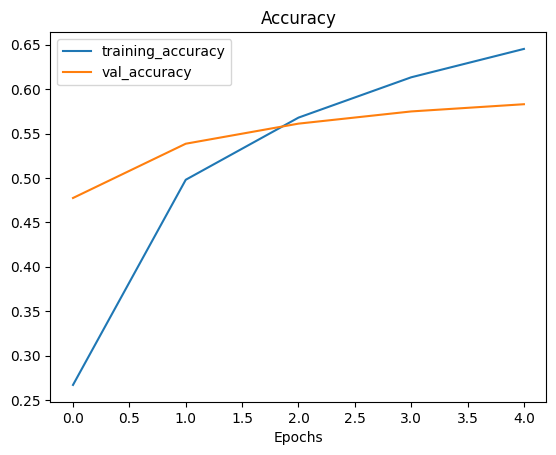

In [ ]:
hf.plot_loss_curves(history_0)

### Make predictions.

1/1 [==============================] - 1s 729ms/step


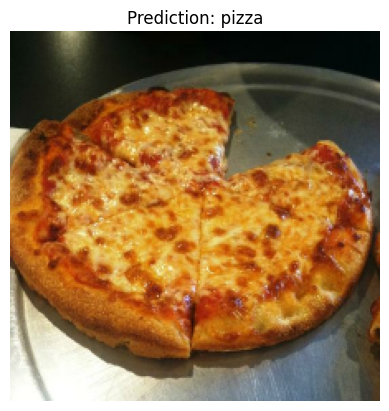

1/1 [==============================] - 0s 17ms/step


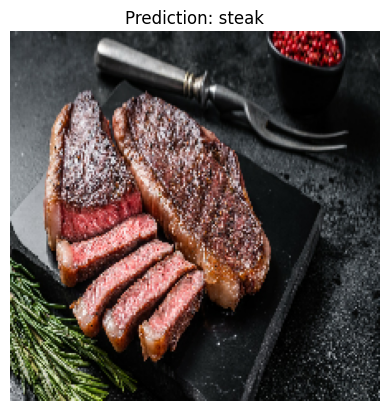

1/1 [==============================] - 0s 15ms/step


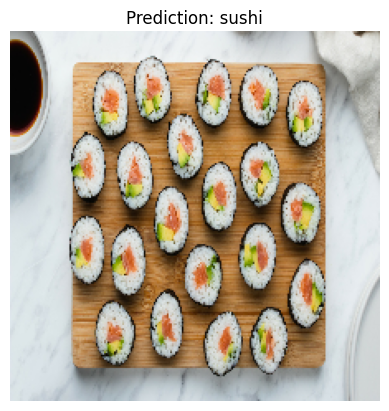

In [ ]:
# Predict from external pictures.
model = model_0
hf.pred_and_plot(model, "images/pizza.jpg", class_names=class_names, scale=False)
hf.pred_and_plot(model, "images/steak.jpg", class_names=class_names, scale=False)
hf.pred_and_plot(model, "images/sushi.jpg", class_names=class_names, scale=False)

1/1 [==============================] - 0s 15ms/step


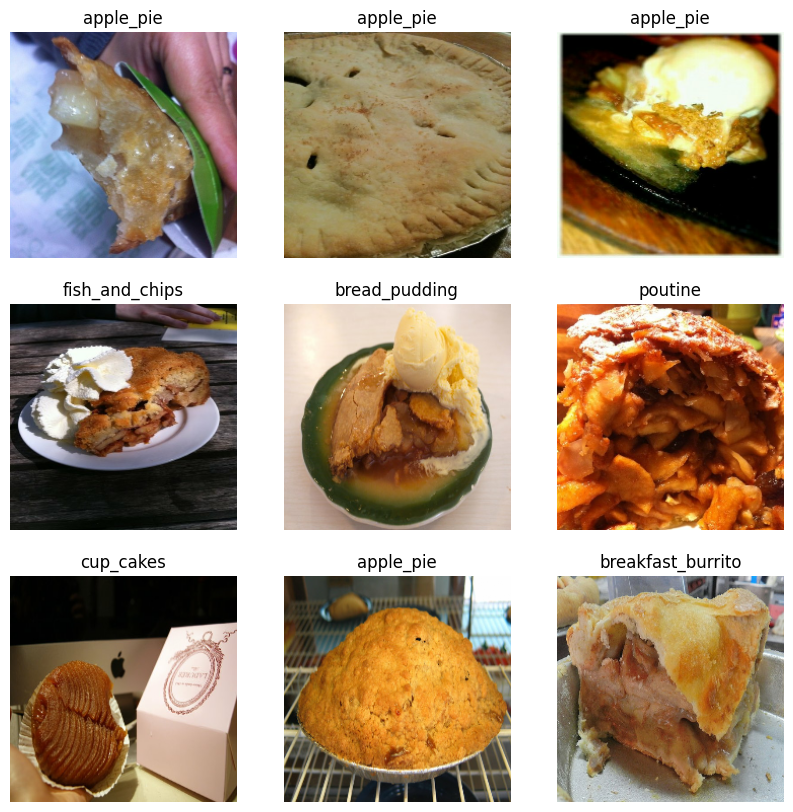

In [ ]:
# Retrieve a batch of images from the test set and predict.
image_batch, label_batch = test_data.as_numpy_iterator().next()
class_names = test_data.class_names
model = model_0

plt.figure(figsize=(10, 10))
for i in range(9):
  img = image_batch[i]
  img = tf.image.resize(img, size=IMG_SIZE)

  pred = model.predict(tf.expand_dims(img, axis=0))
  pred_class = class_names[pred.argmax()]

  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(img/255.)
  plt.title(pred_class)
  plt.axis("off")

### Confusion matrix.

790/790 [==============================] - 41s 51ms/step


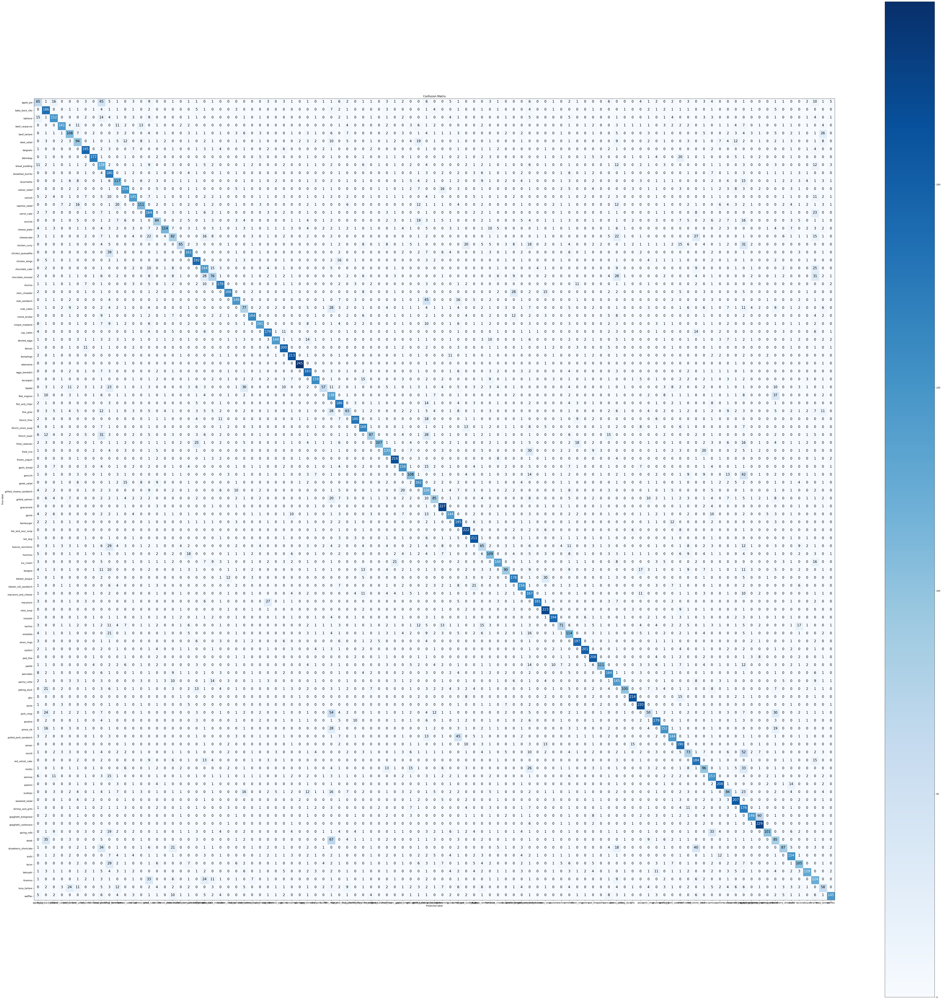

In [ ]:
# Set model
model = model_0

# Get all ground truth labels from test set.
y_true = np.concatenate([y for x, y in test_data], axis=0)
y_true = tf.argmax(y_true, axis=1)
y_true.shape

# Predict on test set.
y_probs = model.predict(test_data)
y_preds = y_probs.argmax(axis=1)
y_preds.shape

# Plot confusion matrix.
hf.make_confusion_matrix(y_true=y_true,
                         y_pred=np.array(y_preds),
                         classes=class_names,
                         figsize=(80, 80))

## `model_1` EfficientNetB0 baseline with fine tuning on 10% of training data with data augmentation.

### Data augmentation.

In [ ]:
# Same as model_0
data_augmentation_layer.summary()

Model: "data_augmentation_layer"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 random_flip_5 (RandomFlip)  (512, 512, 3)             0         
                                                                 
 random_rotation_5 (RandomRo  (512, 512, 3)            0         
 tation)                                                         
                                                                 
 random_height_5 (RandomHeig  (None, 512, 3)           0         
 ht)                                                             
                                                                 
 random_width_5 (RandomWidth  (None, None, 3)          0         
 )                                                               
                                                                 
 random_zoom_5 (RandomZoom)  (None, None, 3)           0         
                                           

### Create the model.

In [ ]:
# Set up input shape and freeze the backbone.
input_shape = IMG_SIZE + (3,)
base_model = tf.keras.applications.EfficientNetB0(include_top=False)
base_model.trainable = False

# Create layers.
inputs = layers.Input(shape=input_shape, name="input_shape")
x = data_augmentation_layer(inputs)
x = base_model(x, training = False)
x = layers.GlobalAveragePooling2D(name="global_avg_pool")(x)
outputs = layers.Dense(len(train_data_10_percent.class_names), activation="softmax", name="output_layer")(x)

# Create model.
model_1 = tf.keras.Model(inputs, outputs)

# Compile modle.
model_1.compile(loss="categorical_crossentropy",
                optimizer=tf.keras.optimizers.Adam(),
                metrics="accuracy")

# Fit model.
initial_epochs = 5
history_1 = model_1.fit(train_data_10_percent,
                        epochs=initial_epochs,
                        steps_per_epoch=len(train_data_10_percent),
                        validation_data=test_data,
                        validation_steps=len(test_data),
                        callbacks=[hf.create_tensorboard_callback(dir_name=TFBOARD_DIR,
                                                                  experiment_name="model_1"),
                                   hf.create_checkpoint_callback(dir_name=CHECKPOINT_DIR,
                                                                 experiment_name="model_1")])

# Get summary.
model_1.summary()

# Freeze all layers except for last 10.
fine_tune_at = 5
base_model.trainable = True
for layer in base_model.layers[:-fine_tune_at]:
  layer.trainable = False

# Compile the model.
model_1.compile(loss="categorical_crossentropy",
                optimizer=tf.keras.optimizers.Adam(lr=0.0001),
                metrics=["accuracy"])

# Fit the model.
fine_tune_epochs = 5
total_epochs = initial_epochs + fine_tune_epochs
history_1_fine = model_1.fit(train_data_10_percent,
                             epochs=total_epochs,
                             steps_per_epoch=len(train_data_10_percent),
                             validation_data=test_data,
                             validation_steps=len(test_data),
                             initial_epoch=history_1.epoch[-1],
                             callbacks=[hf.create_tensorboard_callback(dir_name=TFBOARD_DIR,
                                                                       experiment_name="model_1_fine"),
                                        hf.create_checkpoint_callback(dir_name=CHECKPOINT_DIR,
                                                                      experiment_name="model_1_fine")])

# Get summary.
model_1.summary()

Saving TensorBoard log files to: tensorboard_logs/04-TransferLearning-03-ScalingUp/model_1/20230104-194233
Saving checkpoint to: checkpoints/04-TransferLearning-03-ScalingUp/model_1/checkpoint.ckpt
Epoch 1/5
237/237 [==============================] - ETA: 0s - loss: 3.3790 - accuracy: 0.2688WARNING:tensorflow:Model was constructed with shape (512, 512, 3) for input KerasTensor(type_spec=TensorSpec(shape=(512, 512, 3), dtype=tf.uint8, name='random_flip_5_input'), name='random_flip_5_input', description="created by layer 'random_flip_5_input'"), but it was called on an input with incompatible shape (None, 224, 224, 3).

Epoch 1: val_loss improved from inf to 2.30803, saving model to checkpoints/04-TransferLearning-03-ScalingUp/model_1/checkpoint.ckpt
237/237 [==============================] - 69s 274ms/step - loss: 3.3790 - accuracy: 0.2688 - val_loss: 2.3080 - val_accuracy: 0.4753
Epoch 2/5
237/237 [==============================] - ETA: 0s - loss: 2.2107 - accuracy: 0.4917
Epoch 2: val

/home/santiagorg2401/anaconda3/envs/tf/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/adam.py:114: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)


237/237 [==============================] - ETA: 0s - loss: 1.2154 - accuracy: 0.6826WARNING:tensorflow:Model was constructed with shape (512, 512, 3) for input KerasTensor(type_spec=TensorSpec(shape=(512, 512, 3), dtype=tf.uint8, name='random_flip_5_input'), name='random_flip_5_input', description="created by layer 'random_flip_5_input'"), but it was called on an input with incompatible shape (None, 224, 224, 3).

Epoch 5: val_loss improved from inf to 1.53759, saving model to checkpoints/04-TransferLearning-03-ScalingUp/model_1_fine/checkpoint.ckpt
237/237 [==============================] - 72s 279ms/step - loss: 1.2154 - accuracy: 0.6826 - val_loss: 1.5376 - val_accuracy: 0.5893
Epoch 6/10
237/237 [==============================] - ETA: 0s - loss: 1.0903 - accuracy: 0.7079
Epoch 6: val_loss improved from 1.53759 to 1.51720, saving model to checkpoints/04-TransferLearning-03-ScalingUp/model_1_fine/checkpoint.ckpt
237/237 [==============================] - 66s 278ms/step - loss: 1.0903

### Evaluate the model.

In [ ]:
eval_1 = model_1.evaluate(test_data)

790/790 [==============================] - 43s 54ms/step - loss: 1.5009 - accuracy: 0.6025


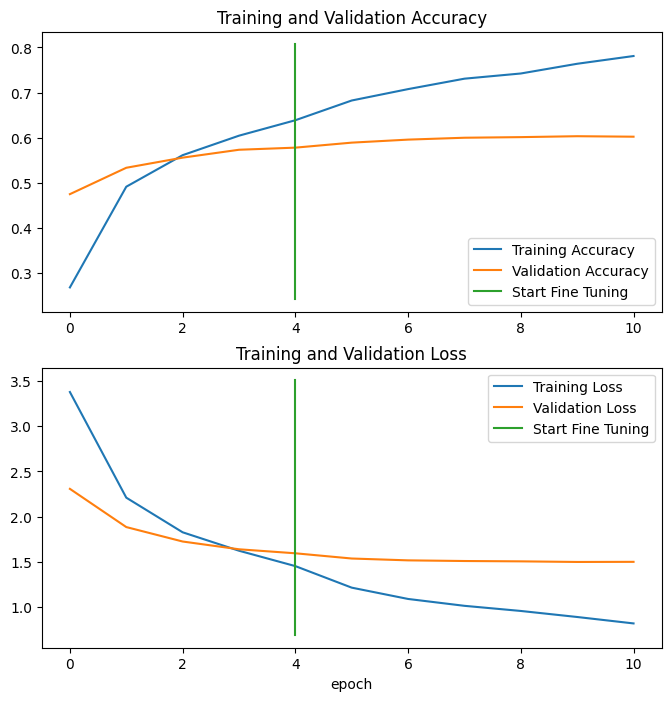

In [ ]:
hf.compare_historys(history_1, history_1_fine, initial_epochs=initial_epochs)

### Make predictions.

1/1 [==============================] - 1s 751ms/step


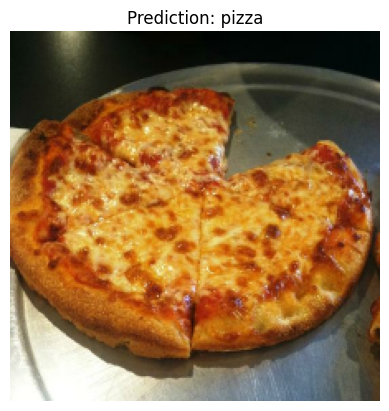

1/1 [==============================] - 0s 16ms/step


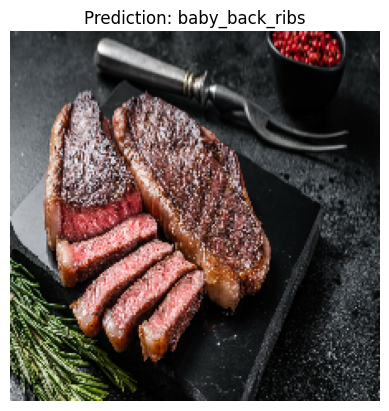

1/1 [==============================] - 0s 19ms/step


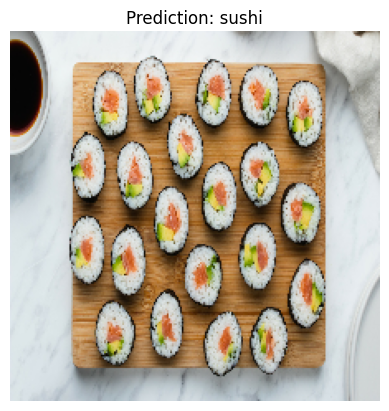

In [ ]:
# Predict from external pictures.
model = model_1
hf.pred_and_plot(model, "images/pizza.jpg", class_names=class_names, scale=False)
hf.pred_and_plot(model, "images/steak.jpg", class_names=class_names, scale=False)
hf.pred_and_plot(model, "images/sushi.jpg", class_names=class_names, scale=False)

1/1 [==============================] - 0s 17ms/step


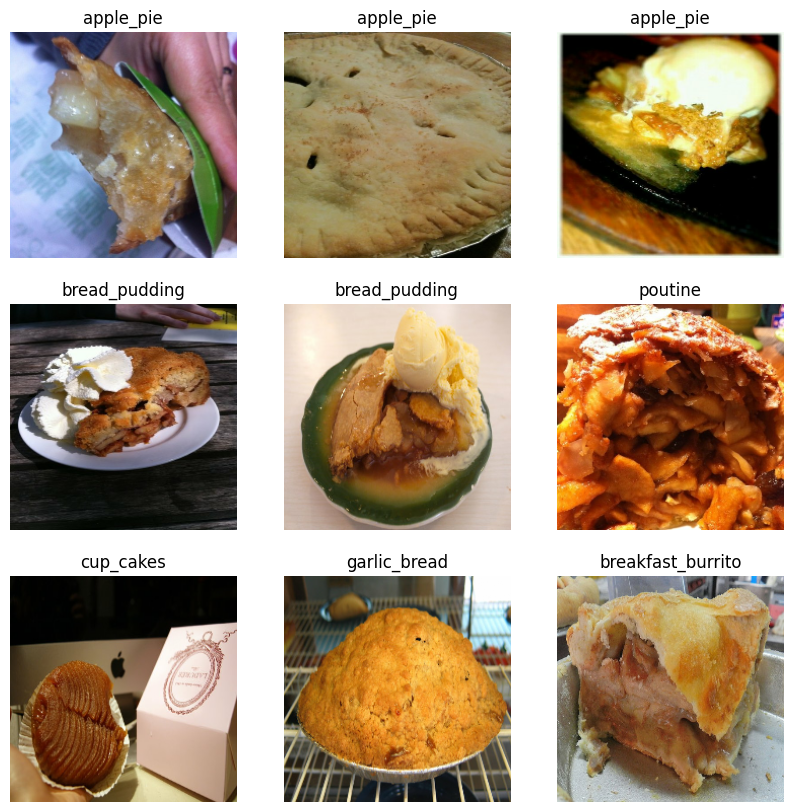

In [ ]:
# Retrieve a batch of images from the test set and predict.
image_batch, label_batch = test_data.as_numpy_iterator().next()
class_names = test_data.class_names
model = model_1

plt.figure(figsize=(10, 10))
for i in range(9):
  img = image_batch[i]
  img = tf.image.resize(img, size=IMG_SIZE)

  pred = model.predict(tf.expand_dims(img, axis=0))
  pred_class = class_names[pred.argmax()]

  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(img/255.)
  plt.title(pred_class)
  plt.axis("off")

### Confusion matrix.

790/790 [==============================] - 44s 55ms/step


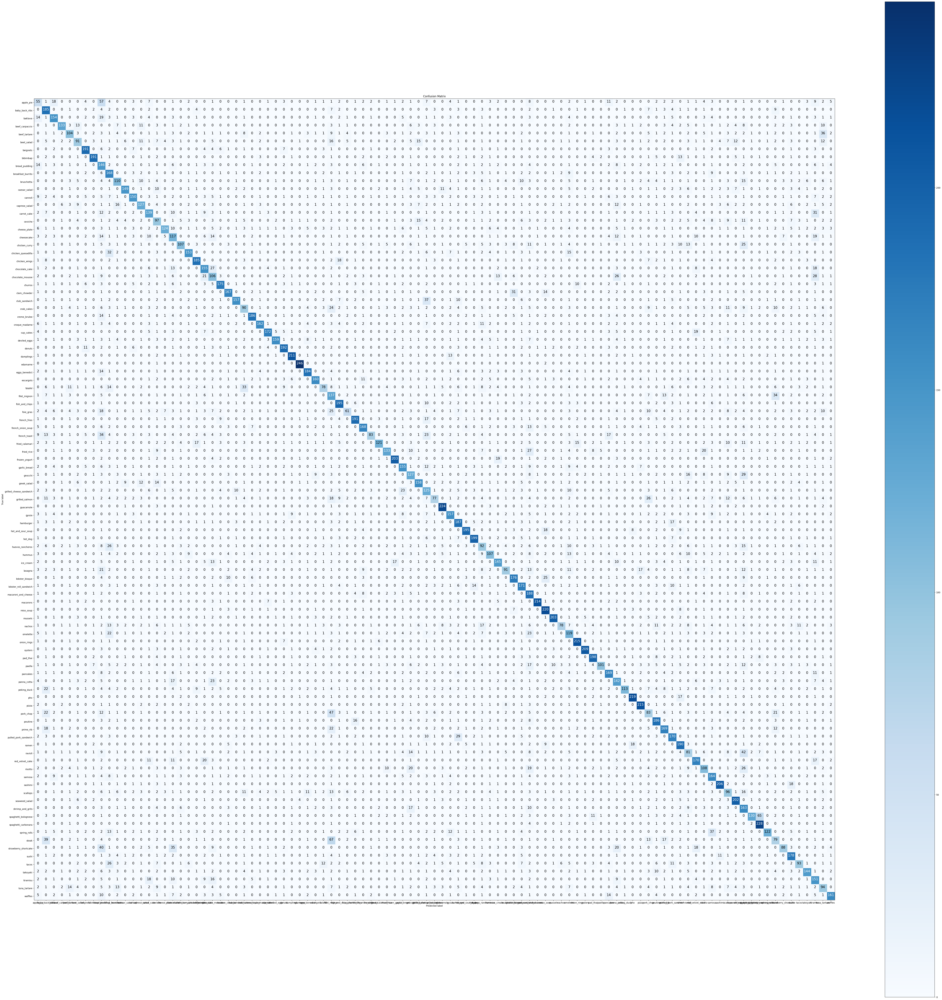

In [ ]:
# Set model
model = model_1

# Get all ground truth labels from test set.
y_true = np.concatenate([y for x, y in test_data], axis=0)
y_true = tf.argmax(y_true, axis=1)
y_true.shape

# Predict on test set.
y_probs = model.predict(test_data)
y_preds = y_probs.argmax(axis=1)
y_preds.shape

# Plot confusion matrix.
hf.make_confusion_matrix(y_true=y_true,
                         y_pred=np.array(y_preds),
                         classes=class_names,
                         figsize=(80, 80))

## `model_2` load model from course GitHub.

### Create the model.

In [3]:
try:
  hf.unzip_data("06_101_food_class_10_percent_saved_big_dog_model.zip")
except:
  !wget https://storage.googleapis.com/ztm_tf_course/food_vision/06_101_food_class_10_percent_saved_big_dog_model.zip
  hf.unzip_data("06_101_food_class_10_percent_saved_big_dog_model.zip")

model_2 = tf.keras.models.load_model("06_101_food_class_10_percent_saved_big_dog_model")

### Evaluate the model. *new stuff here

In [5]:
eval_2 = model_2.evaluate(test_data)

2023-01-05 10:48:17.386019: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100
2023-01-05 10:48:17.950957: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-01-05 10:48:17.951426: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-01-05 10:48:17.951440: W tensorflow/stream_executor/gpu/asm_compiler.cc:80] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2023-01-05 10:48:17.951914: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-01-05 10:48:17.951956: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.


  3/790 [..............................] - ETA: 47s - loss: 3.7971 - accuracy: 0.2292

2023-01-05 10:48:18.419392: I tensorflow/stream_executor/cuda/cuda_blas.cc:1614] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


790/790 [==============================] - 44s 53ms/step - loss: 1.8022 - accuracy: 0.6077


Try something new with Sci-kit learn.

In [6]:
from sklearn.metrics import accuracy_score

model = model_2
pred_classes = model.predict(test_data).argmax(axis=1)

y_labels = []
for images, labels in test_data.unbatch():
  y_labels.append(labels.numpy().argmax())

eval_2_sklearn = accuracy_score(y_true=y_labels,
                                y_pred=pred_classes)
eval_2_sklearn

790/790 [==============================] - 41s 51ms/step


0.6077227722772277

In [7]:
np.isclose(eval_2[1], eval_2_sklearn)

True

Now a classification report.

In [8]:
from sklearn.metrics import classification_report
print(classification_report(y_true=y_labels,
                            y_pred=pred_classes))

              precision    recall  f1-score   support

           0       0.29      0.20      0.24       250
           1       0.51      0.69      0.59       250
           2       0.56      0.65      0.60       250
           3       0.74      0.53      0.62       250
           4       0.74      0.44      0.55       250
           5       0.34      0.54      0.42       250
           6       0.67      0.79      0.72       250
           7       0.82      0.76      0.79       250
           8       0.40      0.37      0.39       250
           9       0.62      0.44      0.52       250
          10       0.62      0.42      0.50       250
          11       0.83      0.48      0.61       250
          12       0.52      0.74      0.61       250
          13       0.56      0.60      0.58       250
          14       0.56      0.59      0.57       250
          15       0.44      0.32      0.37       250
          16       0.45      0.75      0.57       250
          17       0.37    

Make it more visually appealing ...

In [9]:
class_report = classification_report(y_true=y_labels,
                                     y_pred=pred_classes,
                                     output_dict=True)

class_f1_scores = {}

for k,v in class_report.items():
  if k == "accuracy":
    break
  else:
    class_f1_scores[class_names[int(k)]] = v["f1-score"]

class_f1_scores

{'apple_pie': 0.24056603773584903,
 'baby_back_ribs': 0.5864406779661017,
 'baklava': 0.601113172541744,
 'beef_carpaccio': 0.616822429906542,
 'beef_tartare': 0.5477386934673367,
 'beet_salad': 0.4199066874027994,
 'beignets': 0.724264705882353,
 'bibimbap': 0.7908902691511386,
 'bread_pudding': 0.3866943866943867,
 'breakfast_burrito': 0.5152224824355972,
 'bruschetta': 0.5047619047619047,
 'caesar_salad': 0.6126582278481012,
 'cannoli': 0.6125827814569537,
 'caprese_salad': 0.5775193798449612,
 'carrot_cake': 0.574757281553398,
 'ceviche': 0.37122969837587005,
 'cheese_plate': 0.5662650602409639,
 'cheesecake': 0.42689075630252105,
 'chicken_curry': 0.5,
 'chicken_quesadilla': 0.6411889596602972,
 'chicken_wings': 0.7123809523809523,
 'chocolate_cake': 0.45325779036827196,
 'chocolate_mousse': 0.32499999999999996,
 'churros': 0.7121771217712177,
 'clam_chowder': 0.7708779443254817,
 'club_sandwich': 0.7325102880658436,
 'crab_cakes': 0.46153846153846156,
 'creme_brulee': 0.749482401

In [10]:
import pandas as pd
f1_scores = pd.DataFrame({"class_names":list(class_f1_scores.keys()),
                          "f1-score": list(class_f1_scores.values())}).sort_values("f1-score", ascending=False)

In [11]:
f1_scores

,class_names,f1-score
33,edamame,0.935361
63,macarons,0.895397
75,pho,0.869903
91,spaghetti_carbonara,0.847656
69,oysters,0.834008
...,...,...
56,huevos_rancheros,0.336134
22,chocolate_mousse,0.325000
77,pork_chop,0.304850
39,foie_gras,0.297491


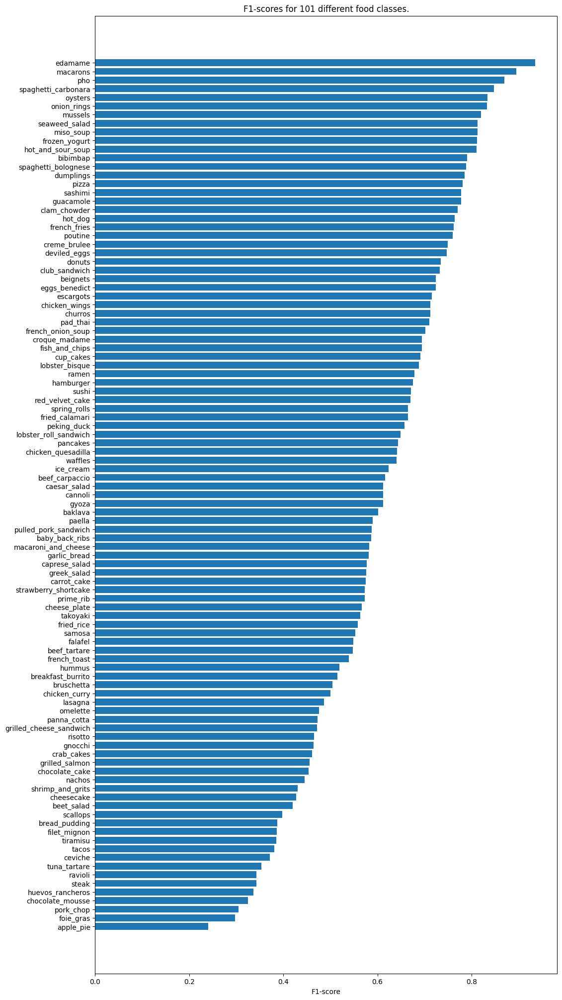

In [12]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 25))
scores = ax.barh(range(len(f1_scores)), f1_scores["f1-score"].values)
ax.set_yticks(range(len(f1_scores)))
ax.set_yticklabels(f1_scores["class_names"])
ax.set_xlabel("F1-score")
ax.set_title("F1-scores for 101 different food classes.")
ax.invert_yaxis()

### Make predictions.

1/1 [==============================] - 1s 829ms/step


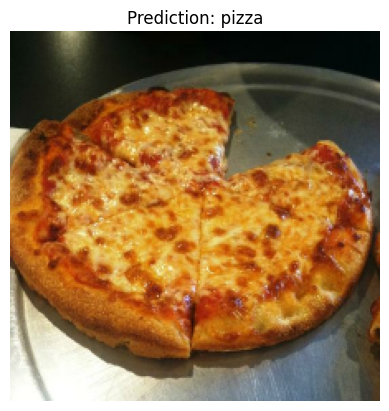

1/1 [==============================] - 0s 31ms/step


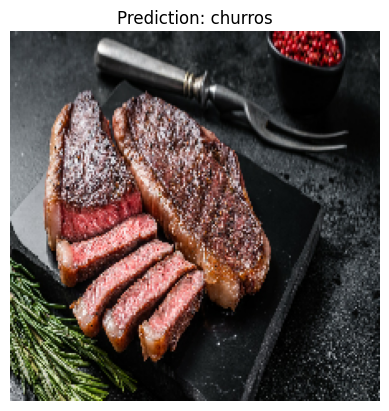

1/1 [==============================] - 0s 19ms/step


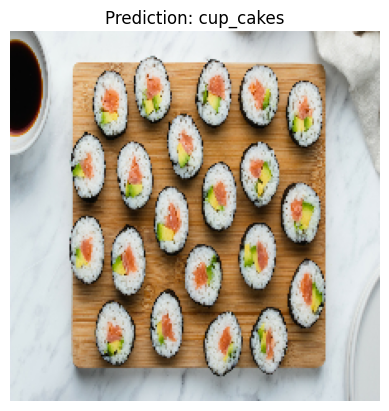

In [13]:
# Predict from external pictures.
model = model_2
hf.pred_and_plot(model, "images/pizza.jpg", class_names=class_names, scale=False)
hf.pred_and_plot(model, "images/steak.jpg", class_names=class_names, scale=False)
hf.pred_and_plot(model, "images/sushi.jpg", class_names=class_names, scale=False)

1/1 [==============================] - 0s 20ms/step


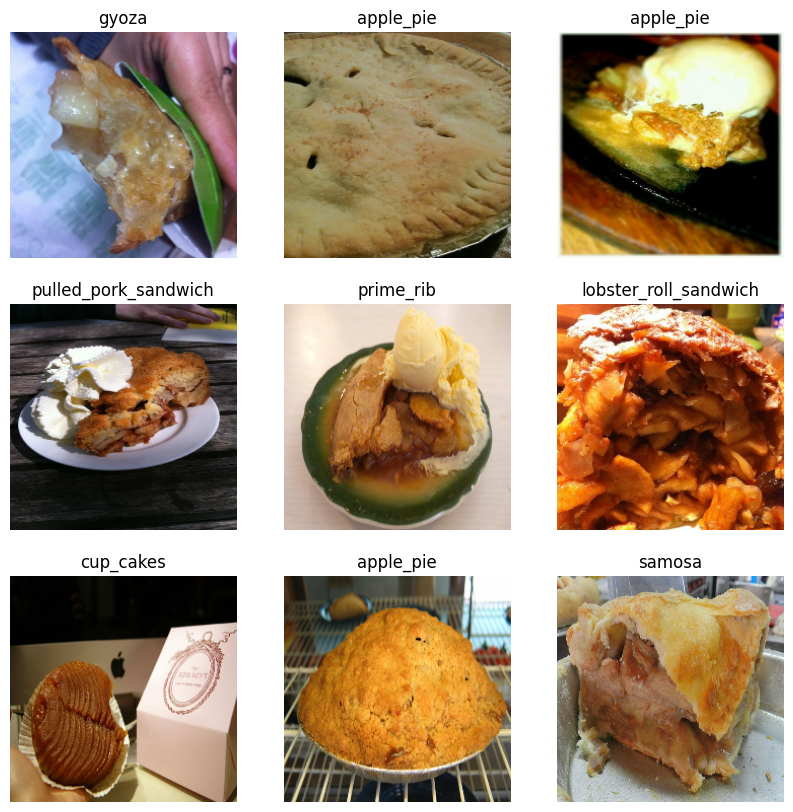

In [14]:
# Retrieve a batch of images from the test set and predict.
image_batch, label_batch = test_data.as_numpy_iterator().next()
class_names = test_data.class_names
model = model_2

plt.figure(figsize=(10, 10))
for i in range(9):
  img = image_batch[i]
  img = tf.image.resize(img, size=IMG_SIZE)

  pred = model.predict(tf.expand_dims(img, axis=0))
  pred_class = class_names[pred.argmax()]

  ax = plt.subplot(3, 3, i + 1)
  plt.imshow(img/255.)
  plt.title(pred_class)
  plt.axis("off")

### Confusion matrix.

790/790 [==============================] - 41s 52ms/step


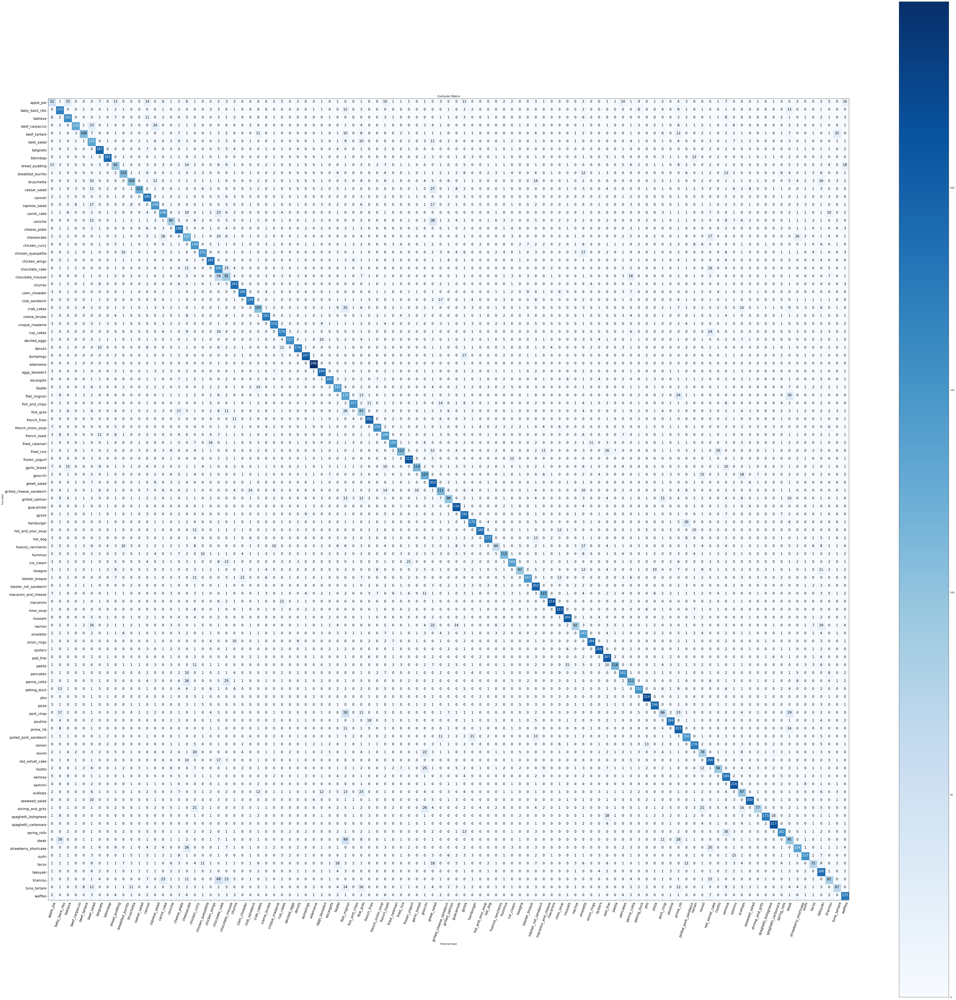

In [15]:
# Set model
model = model_2

# Get all ground truth labels from test set.
y_true = np.concatenate([y for x, y in test_data], axis=0)
y_true = tf.argmax(y_true, axis=1)
y_true.shape

# Predict on test set.
y_probs = model.predict(test_data)
y_preds = y_probs.argmax(axis=1)
y_preds.shape

# Plot confusion matrix.
hf.make_confusion_matrix(y_true=y_true,
                         y_pred=np.array(y_preds),
                         classes=class_names,
                         figsize=(80, 80))

## Evaluate the model, redefined.
Let's redefine helper functions using OOP principles.

In [4]:
from HelperFunctions import ModelHelperFunctions as MHF

model_2_MHF = MHF(img_shape=IMG_SIZE,
                  model=model_2,
                  test_data = test_data)

2023-01-05 12:23:07.980657: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100
2023-01-05 12:23:08.569942: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-01-05 12:23:08.570317: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-01-05 12:23:08.570333: W tensorflow/stream_executor/gpu/asm_compiler.cc:80] Couldn't get ptxas version string: INTERNAL: Couldn't invoke ptxas --version
2023-01-05 12:23:08.570730: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-01-05 12:23:08.570772: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] INTERNAL: Failed to launch ptxas
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.


  4/790 [..............................] - ETA: 40s

2023-01-05 12:23:09.049514: I tensorflow/stream_executor/cuda/cuda_blas.cc:1614] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


790/790 [==============================] - 45s 54ms/step


In [5]:
model_2_MHF.calculate_results()

,0
accuracy,60.772277
precision,0.632794
recall,0.607723
f1,0.606089


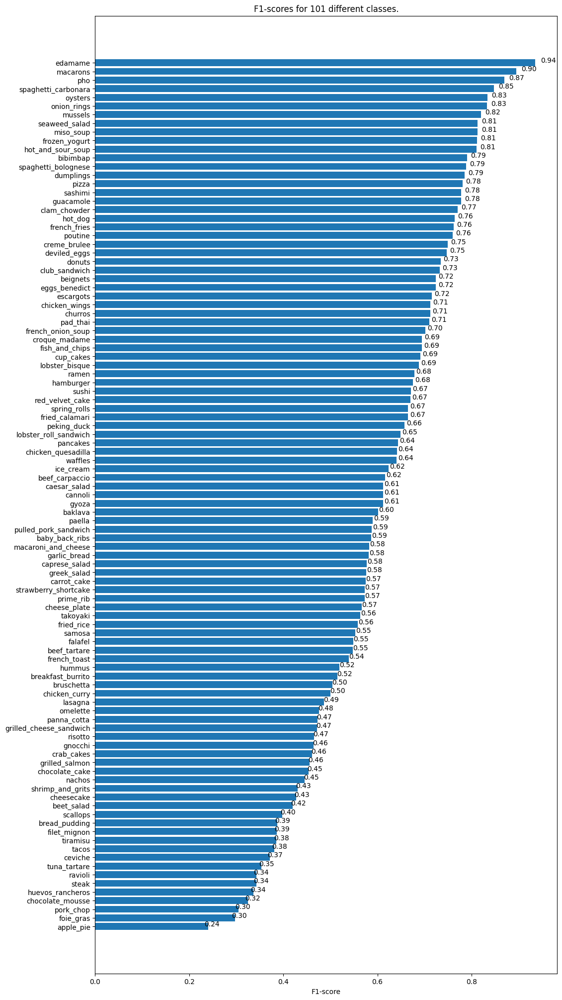

In [6]:
model_2_MHF.make_classification_report()

In [7]:
model_2_MHF.make_confusion_matrix(figsize=(100, 100))

## Make predictions, redefined.

1/1 [==============================] - 1s 797ms/step


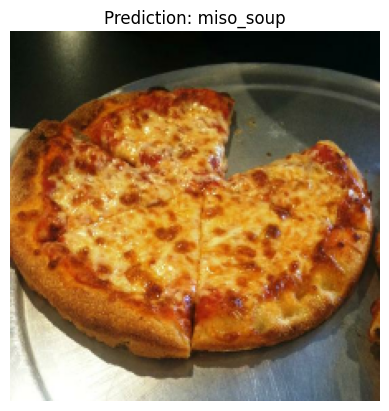

In [8]:
model_2_MHF.pred_and_plot(filename="images/pizza.jpg")

1/1 [==============================] - 0s 16ms/step


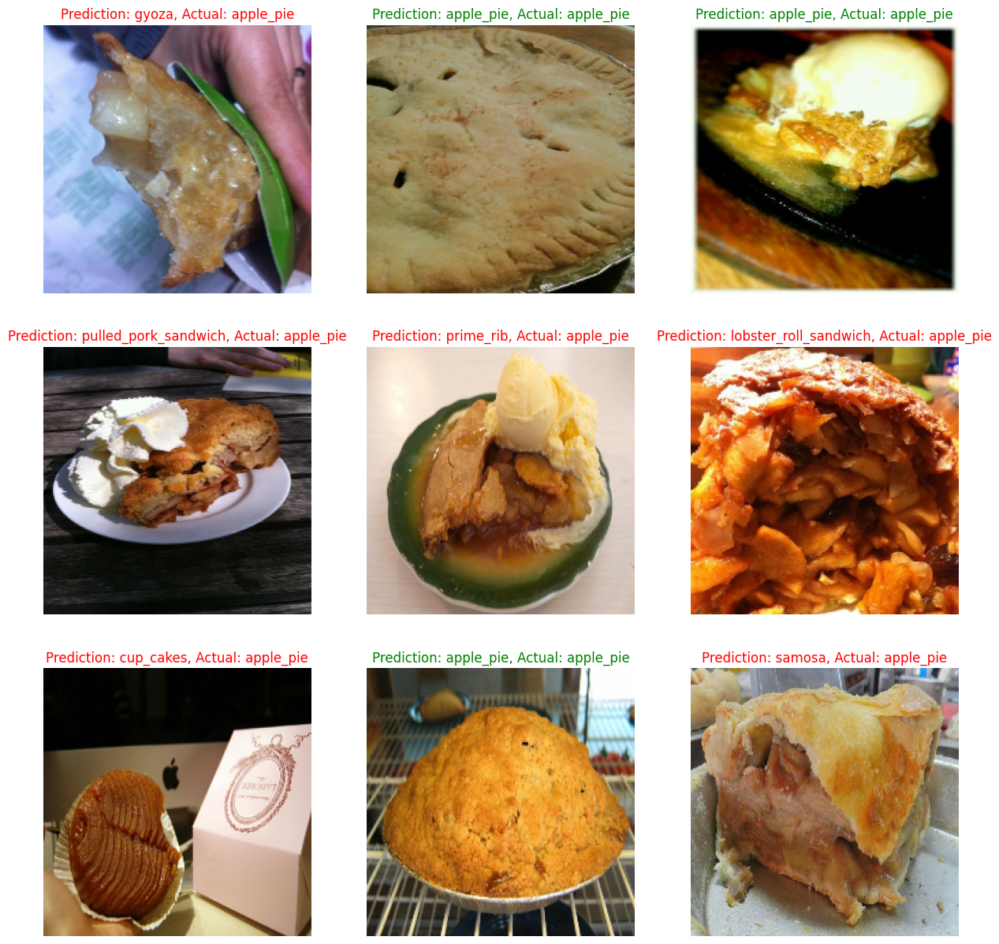

In [9]:
model_2_MHF.pred_from_batch(figsize=(15, 15),numImgs=9)

## Finding the most wrong predictions.
This helps identify how the model is getting confused on certain classes.

In [10]:
pred_df = model_2_MHF.get_preds_df()
pred_df

,img_path,y_true,y_preds,y_probs,y_true_classnames,y_preds_classnames,pred_correct
0,b'101_food_classes_10_percent/test/apple_pie/1...,0,52,0.847670,apple_pie,gyoza,False
1,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,0.963418,apple_pie,apple_pie,True
2,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,0.959456,apple_pie,apple_pie,True
3,b'101_food_classes_10_percent/test/apple_pie/1...,0,80,0.657276,apple_pie,pulled_pork_sandwich,False
4,b'101_food_classes_10_percent/test/apple_pie/1...,0,79,0.363760,apple_pie,prime_rib,False
...,...,...,...,...,...,...,...
25245,b'101_food_classes_10_percent/test/waffles/942...,100,100,0.972674,waffles,waffles,True
25246,b'101_food_classes_10_percent/test/waffles/954...,100,16,0.878751,waffles,cheese_plate,False
25247,b'101_food_classes_10_percent/test/waffles/961...,100,100,0.539674,waffles,waffles,True
25248,b'101_food_classes_10_percent/test/waffles/970...,100,94,0.504459,waffles,strawberry_shortcake,False


In [11]:
top_100_wrong = pred_df[pred_df['pred_correct'] == False].sort_values('y_probs', ascending=False)[:100]
top_100_wrong.head(20)

,img_path,y_true,y_preds,y_probs,y_true_classnames,y_preds_classnames,pred_correct
21810,b'101_food_classes_10_percent/test/scallops/17...,87,29,0.999997,scallops,cup_cakes,False
231,b'101_food_classes_10_percent/test/apple_pie/8...,0,100,0.999995,apple_pie,waffles,False
15359,b'101_food_classes_10_percent/test/lobster_rol...,61,53,0.999988,lobster_roll_sandwich,hamburger,False
23539,b'101_food_classes_10_percent/test/strawberry_...,94,83,0.999987,strawberry_shortcake,red_velvet_cake,False
21400,b'101_food_classes_10_percent/test/samosa/3140...,85,92,0.999982,samosa,spring_rolls,False
24540,b'101_food_classes_10_percent/test/tiramisu/16...,98,83,0.999946,tiramisu,red_velvet_cake,False
2511,b'101_food_classes_10_percent/test/bruschetta/...,10,61,0.999945,bruschetta,lobster_roll_sandwich,False
5574,b'101_food_classes_10_percent/test/chocolate_m...,22,21,0.999939,chocolate_mousse,chocolate_cake,False
17855,b'101_food_classes_10_percent/test/paella/2314...,71,65,0.999931,paella,mussels,False
23797,b'101_food_classes_10_percent/test/sushi/16593...,95,86,0.999904,sushi,sashimi,False


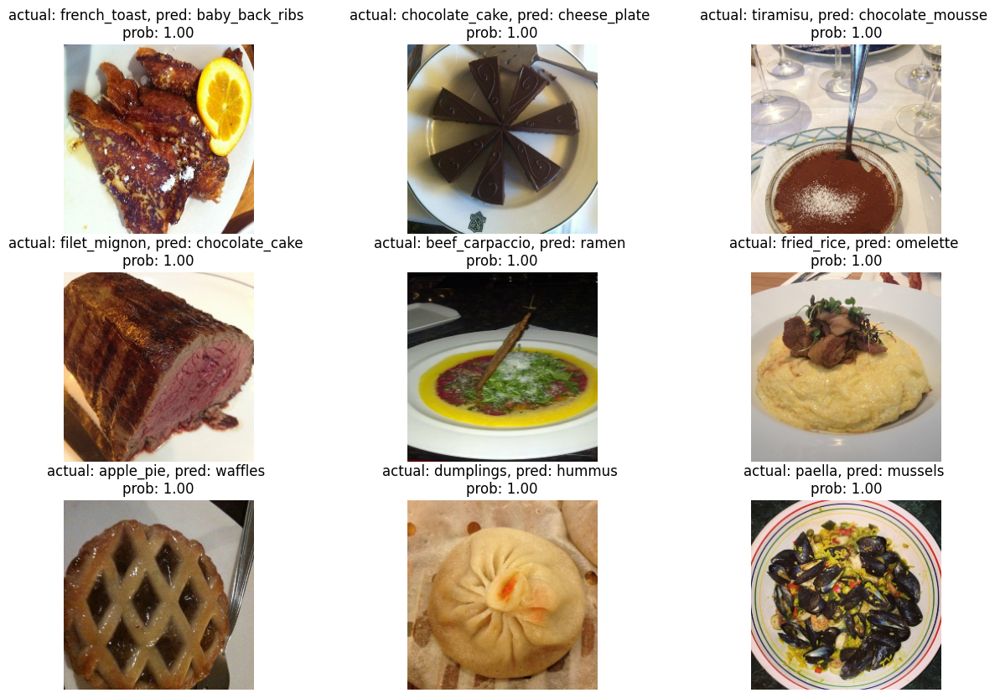

In [13]:
model_2_MHF.plot_most_wrong_preds(startIndex=20)